<a href="https://colab.research.google.com/github/pranay8297/deep-learning-projects/blob/master/facenet_pytorch_yapp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# INITIAL EXPERIMENTS

In [2]:
!pip install facenet-pytorch
!pip install ipdb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 26.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 21.1 MB/s eta 0:00:00


In [83]:
from facenet_pytorch import MTCNN
import cv2
from PIL import Image, ImageOps
import numpy as np
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
import torch
from torchvision import transforms

In [7]:
device = torch.device('cuda:0')

In [4]:
mtcnn = MTCNN(select_largest=False, device='cuda')

In [ ]:
from google.colab import files
files.upload()

In [ ]:
!unzip ./agqphdxmwt.mp4.zip

Archive:  ./agqphdxmwt.mp4.zip
  inflating: agqphdxmwt.mp4          


In [ ]:
!ls

agqphdxmwt.mp4	agqphdxmwt.mp4.zip  sample_data


In [ ]:
# Load an image
v_cap = cv2.VideoCapture('./agqphdxmwt.mp4')
success, frame = v_cap.read()
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
frame = Image.fromarray(frame)


In [ ]:
success

True

(-0.5, 1919.5, 1079.5, -0.5)

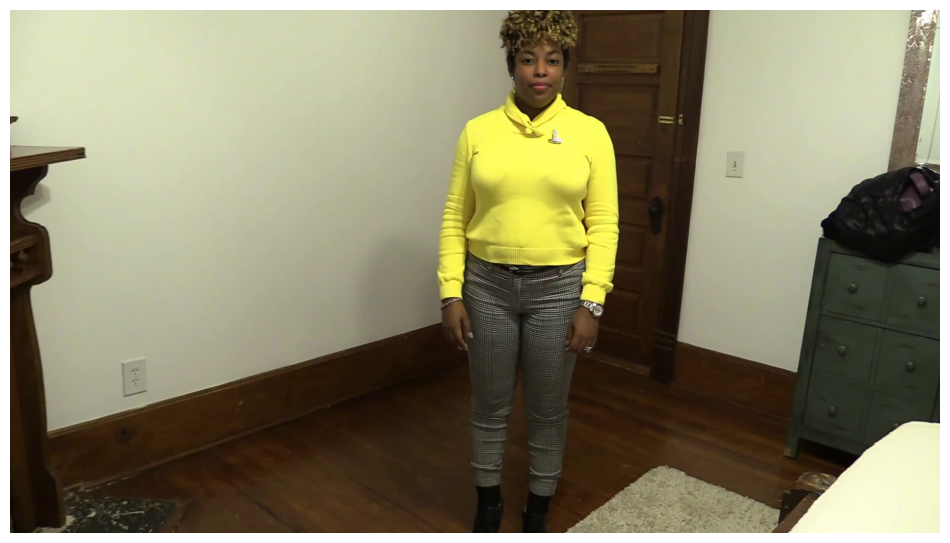

In [ ]:
plt.figure(figsize=(12, 8))
plt.imshow(frame)
plt.axis('off')

In [ ]:
face = mtcnn(frame)
face.shape

torch.Size([3, 160, 160])

In [ ]:
from torchvision.transforms import ToPILImage

In [ ]:
to_pil = ToPILImage()
image = to_pil(face)
image.show()

In [ ]:
face.shape

torch.Size([3, 160, 160])

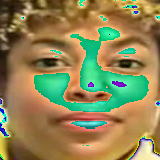

In [ ]:
image

In [ ]:
tensor = torch.rand(3,300,700)
img = to_pil(tensor)
img.show()

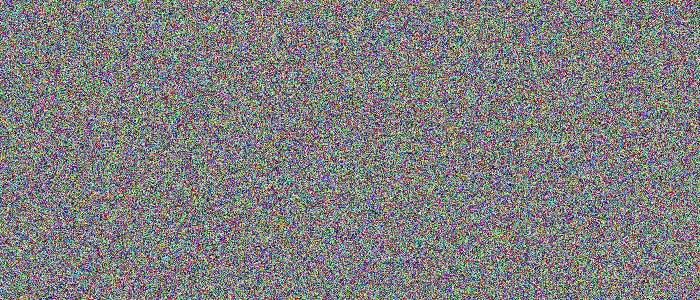

In [ ]:
img

In [ ]:
mtcnn = None
import gc
gc.collect()
torch.cuda.empty_cache()

In [ ]:
mtcnn = MTCNN(select_largest = False, post_process = False, device = 'cuda')

In [ ]:
face = mtcnn(frame)

In [ ]:
face.dtype

torch.float32

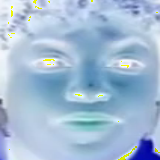

In [ ]:
to_pil(face)

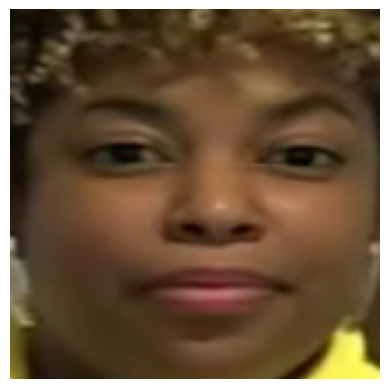

In [ ]:
plt.imshow(face.permute(1, 2, 0).int().numpy())
plt.axis('off');

In [ ]:
mtcnn = None
gc.collect()
torch.cuda.empty_cache()

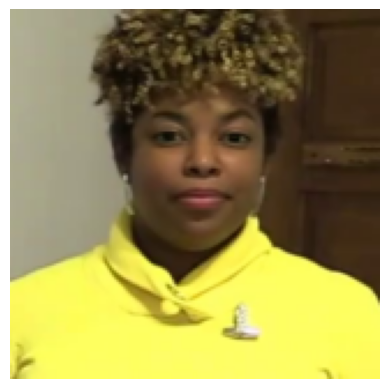

In [ ]:
mtcnn = MTCNN(margin=100, select_largest=False, post_process=False, device='cuda:0')

# Detect face
face = mtcnn(frame)

# Visualize
plt.imshow(face.permute(1, 2, 0).int().numpy())
plt.axis('off');

In [ ]:
mtcnn = None
gc.collect()
torch.cuda.empty_cache()

In [ ]:
mtcnn = MTCNN(margin=100, select_largest=False, post_process=True, device='cuda:0')

# Detect face
face = mtcnn(frame)

In [ ]:
face

tensor([[[ 0.3789,  0.3789,  0.3789,  ..., -0.5195, -0.5195, -0.5117],
         [ 0.3789,  0.3789,  0.3789,  ..., -0.5195, -0.5195, -0.5117],
         [ 0.3789,  0.3789,  0.3789,  ..., -0.5195, -0.5195, -0.5195],
         ...,
         [ 0.7773,  0.7461,  0.5039,  ...,  0.9883,  0.9883,  0.9883],
         [ 0.8086,  0.5977,  0.3555,  ...,  0.9883,  0.9883,  0.9883],
         [ 0.6523,  0.3789,  0.2773,  ...,  0.9883,  0.9883,  0.9883]],

        [[ 0.3789,  0.3789,  0.3789,  ..., -0.6602, -0.6602, -0.6523],
         [ 0.3789,  0.3789,  0.3789,  ..., -0.6602, -0.6602, -0.6523],
         [ 0.3789,  0.3789,  0.3789,  ..., -0.6602, -0.6602, -0.6602],
         ...,
         [ 0.7070,  0.6680,  0.4336,  ...,  0.9570,  0.9570,  0.9570],
         [ 0.7383,  0.5195,  0.2773,  ...,  0.9570,  0.9570,  0.9570],
         [ 0.5742,  0.2930,  0.1992,  ...,  0.9570,  0.9570,  0.9570]],

        [[ 0.1445,  0.1367,  0.1289,  ..., -0.8086, -0.8086, -0.8008],
         [ 0.1445,  0.1367,  0.1289,  ..., -0

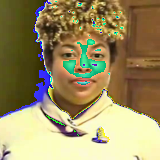

In [ ]:
to_pil(face)

# MULTIPLE FACES

In [ ]:
files.upload()

In [ ]:
!unzip ./avibnnhwhp.mp4.zip

Archive:  ./avibnnhwhp.mp4.zip
  inflating: avibnnhwhp.mp4          


In [ ]:
v_cap = cv2.VideoCapture('./avibnnhwhp.mp4')
success, frame = v_cap.read()
frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
frame = Image.fromarray(frame)

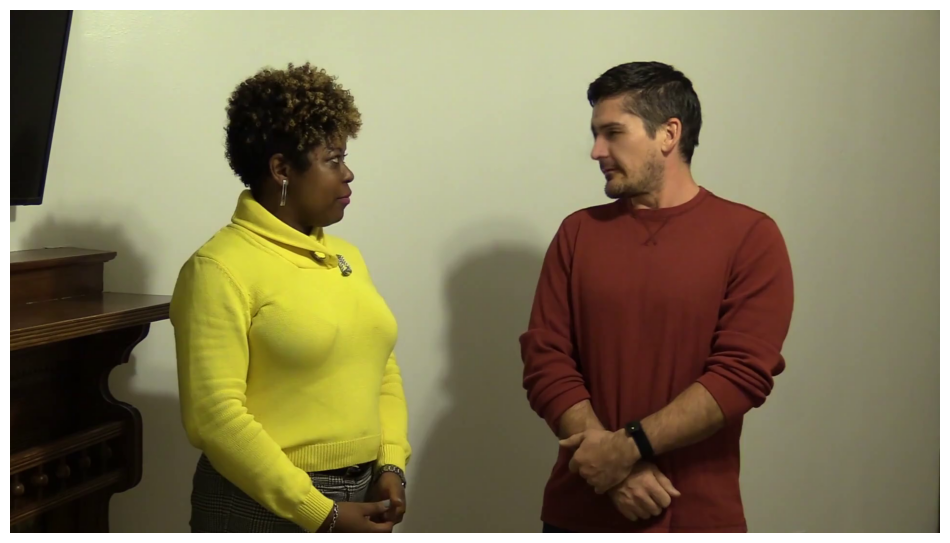

In [ ]:
plt.figure(figsize = (12, 8))
plt.imshow(frame)
plt.axis('off')
plt.show()

In [ ]:
mtcnn = None
gc.collect()
torch.cuda.empty_cache()

In [ ]:
mtcnn = MTCNN(margin = 40, keep_all=True, post_process=False, device='cuda:0')

In [ ]:
faces = mtcnn(frame)

In [ ]:
faces.shape

torch.Size([2, 3, 160, 160])

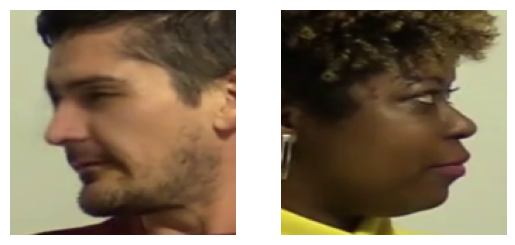

In [ ]:
fig, axis = plt.subplots(1, 2)
for face, ax in zip(faces, axis):
  ax.imshow(face.permute(1, 2, 0).int().numpy())
  ax.axis('off')
fig.show()

In [ ]:
v_cap = cv2.VideoCapture('./avibnnhwhp.mp4')
v_len = int(v_cap.get(cv2.CAP_PROP_FRAME_COUNT))

In [ ]:
cv2.CAP_PROP_FRAME_COUNT

7

In [ ]:
v_len

300

In [ ]:
frames = []
for i in tqdm(range(v_len)):

    # Load frame
    success = v_cap.grab()
    if i % 50 == 0:
        success, frame = v_cap.retrieve()
    else:
        continue
    if not success:
        continue

    # Add to batch
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frames.append(Image.fromarray(frame))

  0%|          | 0/300 [00:00<?, ?it/s]

In [ ]:
??mtcnn.forward

In [ ]:
out = mtcnn(frames[0], return_prob = False)

In [ ]:
faces = mtcnn(frames)

In [ ]:
for i in faces:
  print(i.shape)

torch.Size([2, 3, 160, 160])
torch.Size([2, 3, 160, 160])
torch.Size([2, 3, 160, 160])
torch.Size([2, 3, 160, 160])
torch.Size([2, 3, 160, 160])
torch.Size([2, 3, 160, 160])


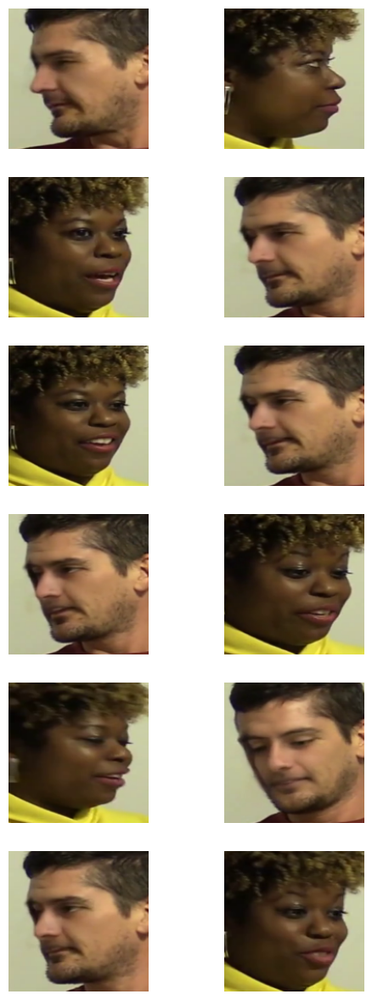

In [ ]:
fig, axis = plt.subplots(len(faces), 2, figsize = (6, 15))

for i, fs in enumerate(faces):
  for j, ax in enumerate(axis[i]):
    ax.imshow(faces[i][j].squeeze().int().permute(1, 2, 0).numpy())
    ax.axis('off')

fig.show()


# FACE EXTRCTION FLOW

In [6]:
# Mount to google drive
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!ls

drive  sample_data


In [ ]:
!cd drive

In [ ]:
!ls drive/MyDrive/Yapp_experiment_photos

0A94EBCD-489F-4221-8C3B-755FDBC0F985.JPG
30F6312B-B98E-4F00-9852-3DEB80575915.JPG
52D0C9B3-1A9D-49DD-BA67-5FAAAB9B7BE2.JPG
6050EC9E-BE5F-4445-882B-B1E5D855D1DD.JPG
6B6C81DA-5A57-40C2-A8FA-D2CFDD7820D5.JPG
7DF79CCE-7143-4B6B-9648-0D963F5AF02E.JPG
8C1F3CC0-0BD2-4373-B5AE-7B908C894E38.JPG
932C138B-0BF5-43CB-8314-431190E41762.JPG
A3E6937A-FC58-4E3C-A04E-7CD9EE162D57.JPG
B8A25C03-9621-4E6E-BC22-ED07F4518F64.JPG
BD1F352D-1621-4557-8964-E47C19EBE84D.JPG
D7912065-5031-4572-96B9-F11E874A5869.JPG
DBC4EA03-8B12-442C-9456-F4AE0DC45088.JPG
E8C54CCC-025B-4B30-8B86-BF65254C16F3.JPG


In [ ]:
mtcnn = MTCNN(margin=20, keep_all=True, post_process=False, device='cuda:0')

In [ ]:
?? mtcnn.forward

In [ ]:
# 1. Read a photo from the file path - done
# 2. check its size - done
# 3. check the tensor values - Done
# 4. resize the image - done
# 5. pass it to the model with different sizes and experiment.
# 6. extract the faces

In [ ]:
# 1
??Image.open

In [ ]:
sample_image = Image.open('./drive/MyDrive/Yapp_experiment_photos/30F6312B-B98E-4F00-9852-3DEB80575915.JPG')

In [ ]:
sample_image.size

(4032, 3024)

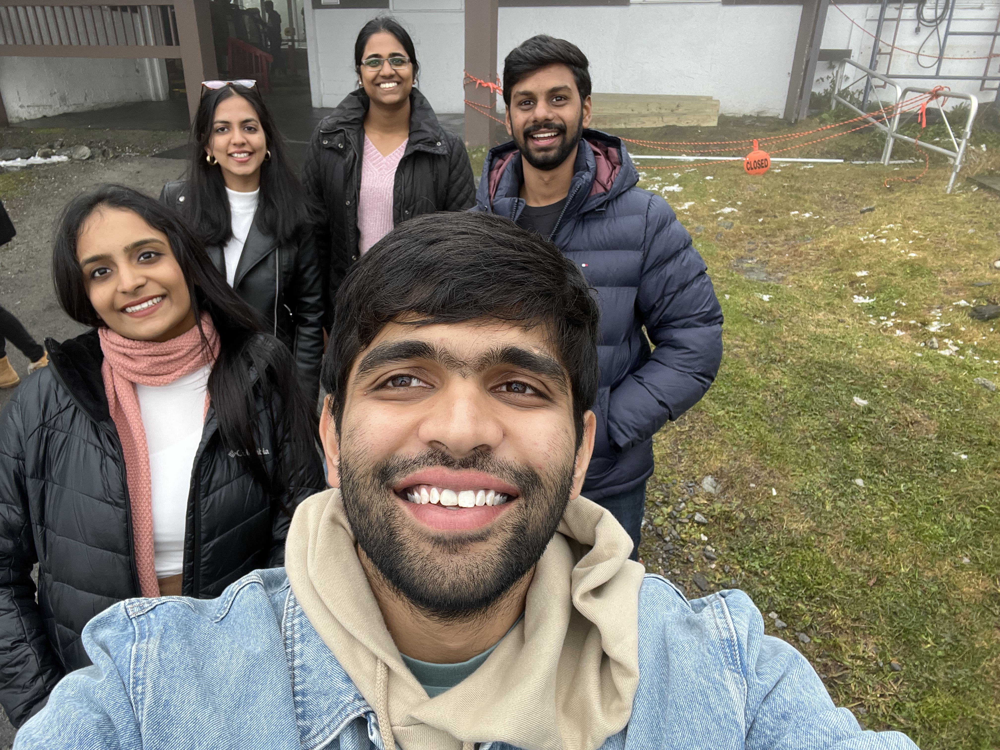

In [ ]:
sample_image.rotate(180)

In [31]:
im = sample_image.rotate(180)

In [36]:
sizes = im.size

In [40]:
sizes[0]/4

1008.0

In [42]:
resized_im = im.resize((int(sizes[0]/8), int(sizes[1]/8)))

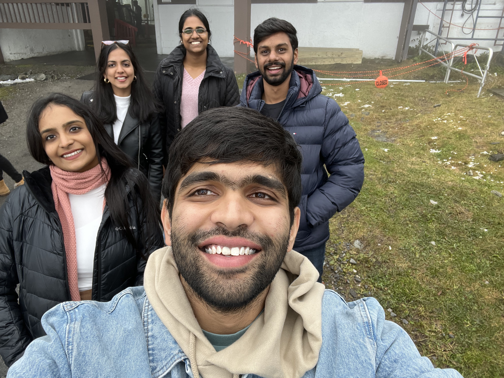

In [43]:
resized_im

In [47]:
trans = transforms.ToTensor()
im_tensor = trans(resized_im)

In [49]:
im_tensor.shape

torch.Size([3, 378, 504])

In [53]:
im_tensor.shape, im_tensor

(torch.Size([3, 378, 504]),
 tensor([[[0.3255, 0.3294, 0.3294,  ..., 0.7490, 0.7255, 0.6902],
          [0.3294, 0.3333, 0.3412,  ..., 0.7255, 0.6824, 0.6627],
          [0.3255, 0.3294, 0.3373,  ..., 0.7255, 0.6941, 0.6627],
          ...,
          [0.3098, 0.3373, 0.3333,  ..., 0.3059, 0.2784, 0.2902],
          [0.3020, 0.3451, 0.4235,  ..., 0.4235, 0.3765, 0.3451],
          [0.2588, 0.4039, 0.4235,  ..., 0.4745, 0.4627, 0.4196]],
 
         [[0.3020, 0.3020, 0.3020,  ..., 0.7529, 0.7255, 0.6902],
          [0.3020, 0.3059, 0.3098,  ..., 0.7294, 0.6824, 0.6588],
          [0.3020, 0.3020, 0.3020,  ..., 0.7294, 0.6941, 0.6627],
          ...,
          [0.3176, 0.3451, 0.3412,  ..., 0.2980, 0.2706, 0.2824],
          [0.3176, 0.3569, 0.4275,  ..., 0.3961, 0.3529, 0.3255],
          [0.2667, 0.4118, 0.4196,  ..., 0.4588, 0.4275, 0.3843]],
 
         [[0.2706, 0.2706, 0.2784,  ..., 0.7373, 0.7176, 0.6824],
          [0.2706, 0.2745, 0.2824,  ..., 0.7098, 0.6745, 0.6510],
          [0

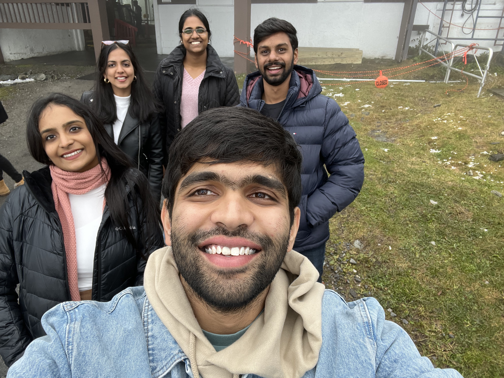

In [51]:
transforms.ToPILImage()(im_tensor)

In [55]:
?? mtcnn

In [56]:
mtcnn = MTCNN(margin = 40, keep_all=True, post_process=False, device='cuda:0')

In [63]:
faces = mtcnn(im)

In [61]:
faces.shape

torch.Size([5, 3, 160, 160])

In [64]:
faces.shape

torch.Size([6, 3, 160, 160])

In [65]:
mtcnn_1 = MTCNN(margin = 40, keep_all=True, post_process=True, device='cuda:0')

In [67]:
p_faces = mtcnn_1(resized_im)

In [68]:
p_faces.shape

torch.Size([5, 3, 160, 160])

In [69]:
trans_1 = transforms.ToPILImage()
images = [trans_1(i) for i in p_faces]

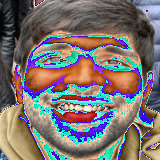

In [70]:
images[0]

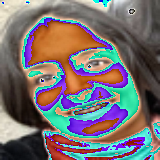

In [71]:
images[1]

In [74]:
up_faces = mtcnn(resized_im)
images = [trans_1(i) for i in up_faces]

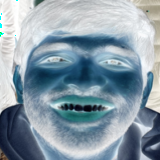

In [75]:
images[0]

In [10]:
mtcnn = MTCNN(
    image_size=160, margin=0, min_face_size=20,
    thresholds=[0.6, 0.7, 0.7], factor=0.709, post_process=True, keep_all = True,
    device=device
)

In [11]:
from facenet_pytorch import InceptionResnetV1
resnet = InceptionResnetV1(pretrained = 'vggface2').eval().to(device)

  0%|          | 0.00/107M [00:00<?, ?B/s]

In [16]:
!ls drive/MyDrive/Yapp_experiment_photos/

0A94EBCD-489F-4221-8C3B-755FDBC0F985.JPG
30F6312B-B98E-4F00-9852-3DEB80575915.JPG
52D0C9B3-1A9D-49DD-BA67-5FAAAB9B7BE2.JPG
6050EC9E-BE5F-4445-882B-B1E5D855D1DD.JPG
7DF79CCE-7143-4B6B-9648-0D963F5AF02E.JPG
A3E6937A-FC58-4E3C-A04E-7CD9EE162D57.JPG
BD1F352D-1621-4557-8964-E47C19EBE84D.JPG
D7912065-5031-4572-96B9-F11E874A5869.JPG
DBC4EA03-8B12-442C-9456-F4AE0DC45088.JPG
E8C54CCC-025B-4B30-8B86-BF65254C16F3.JPG
Manogna_individual.JPG
Sahana_individual.JPG
Sanjana_inidividual.JPG
Sasank_individual.JPG


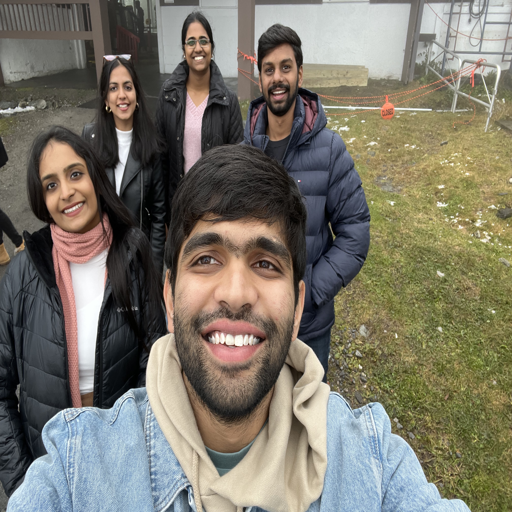

In [18]:
all_present_photo = Image.open('drive/MyDrive/Yapp_experiment_photos/30F6312B-B98E-4F00-9852-3DEB80575915.JPG').resize((512, 512)).rotate(180)
all_present_photo

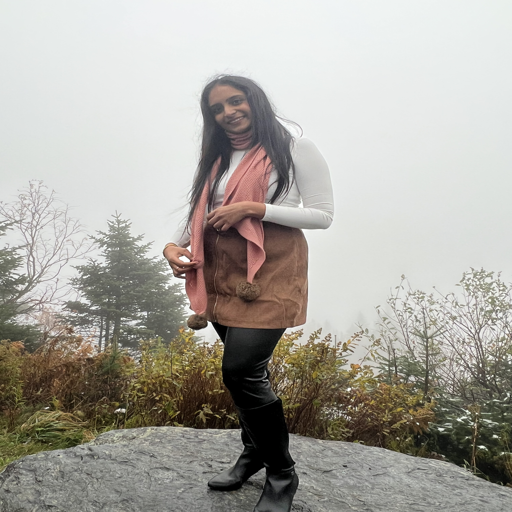

In [21]:
s_photo = Image.open('drive/MyDrive/Yapp_experiment_photos/Sanjana_inidividual.JPG').resize((512, 512)).rotate(-90)
s_photo

In [23]:
faces, probs = mtcnn([all_present_photo, s_photo], return_prob = True)

In [27]:
faces[0].shape, faces[1].shape

(torch.Size([5, 3, 160, 160]), torch.Size([1, 3, 160, 160]))

In [29]:
all_faces = torch.cat(faces, dim = 0)

In [30]:
all_faces.shape

torch.Size([6, 3, 160, 160])

In [35]:
all_faces = all_faces.to(device)

In [37]:
all_faces.device

device(type='cuda', index=0)

In [38]:
embeddings = resnet(all_faces).detach().cpu()

In [39]:
embeddings.shape

torch.Size([6, 512])

In [40]:
torch.dot(embeddings[0], embeddings[-1])

tensor(0.0616)

In [41]:
torch.dot(embeddings[1], embeddings[-1])

tensor(0.8867)

In [42]:
torch.dot(embeddings[2], embeddings[-1])

tensor(-0.0834)

In [43]:
torch.dot(embeddings[3], embeddings[-1])

tensor(0.3272)

In [44]:
torch.dot(embeddings[4], embeddings[-1])

tensor(0.2984)

In [45]:
torch.dot(embeddings[5], embeddings[-1])

tensor(1.)

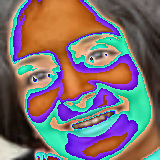

In [48]:
to_pil = transforms.ToPILImage()
to_pil(faces[0][1])

# With Inverted Images

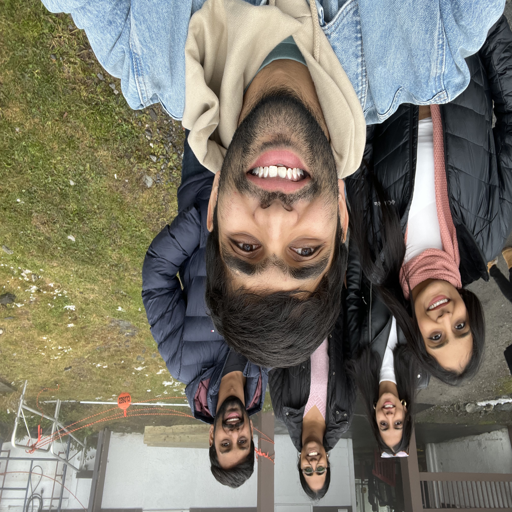

In [49]:
all_present_photo = Image.open('drive/MyDrive/Yapp_experiment_photos/30F6312B-B98E-4F00-9852-3DEB80575915.JPG').resize((512, 512))
all_present_photo

In [50]:
i_faces, probs = mtcnn(all_present_photo, return_prob = True)

In [52]:
i_faces.shape

torch.Size([4, 3, 160, 160])

In [53]:
imgs = [to_pil(i) for i in i_faces]

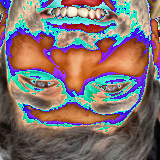

In [55]:
imgs[0]

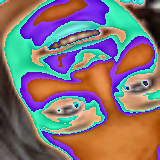

In [56]:
imgs[1]

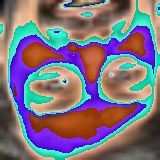

In [57]:
imgs[2]

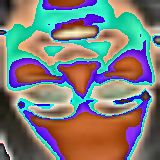

In [58]:
imgs[3]

In [59]:
mtcnn_1 = MTCNN(
    image_size=160, margin=0, min_face_size=20,
    thresholds=[0.5, 0.5, 0.5], factor=0.709, post_process=True, keep_all = True,
    device=device
)

In [60]:
i_faces, probs = mtcnn_1(all_present_photo, return_prob = True)
i_faces.shape

torch.Size([5, 3, 160, 160])

In [61]:
i_embs = resnet(i_faces.to(device)).detach().cpu()

In [62]:
result = torch.matmul(embeddings, i_embs.t()).detach()

In [63]:
result

tensor([[ 0.1191,  0.1658, -0.1218, -0.1544, -0.0573],
        [ 0.0031,  0.0353,  0.0990, -0.0228,  0.0606],
        [ 0.1078, -0.0809,  0.0729, -0.1015,  0.1437],
        [-0.1265, -0.0531, -0.0245, -0.1437, -0.0896],
        [ 0.1460,  0.1090,  0.2322,  0.0529,  0.2008],
        [-0.0138,  0.1173,  0.1574,  0.0215,  0.0811]])

In [64]:
i_imgs = [to_pil(i) for i in i_faces]

In [70]:
imgs = [to_pil(i) for i in all_faces.to('cpu')]

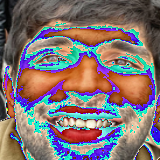

In [71]:
imgs[0]

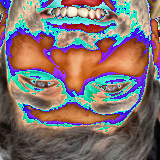

In [72]:
i_imgs[0]

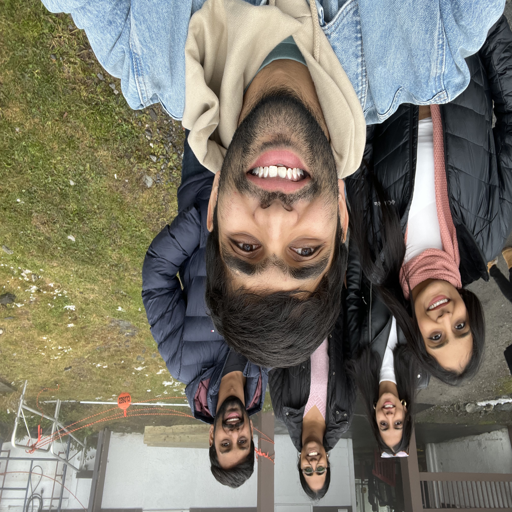

In [73]:
all_present_photo

In [75]:
all_present_photo._getexif()

AttributeError: ignored

In [ ]:
all_present_photo.info['exif']

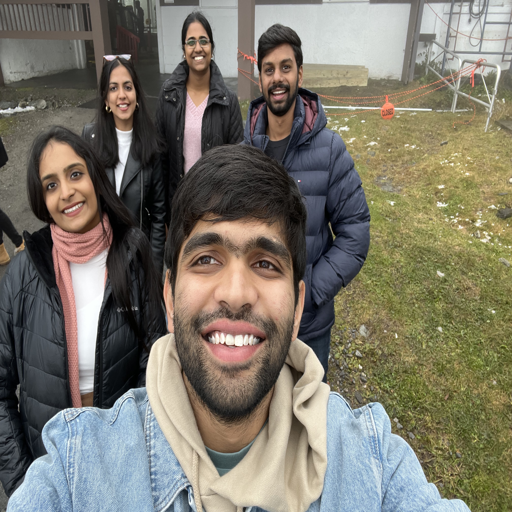

In [85]:
ImageOps.exif_transpose(all_present_photo)